# Custom Training with YOLOv5

In this tutorial, we assemble a dataset and train a custom YOLOv5 model to recognize the objects in our dataset. To do so we will take the following steps:

* Gather a dataset of images and label our dataset
* Export our dataset to YOLOv5
* Train YOLOv5 to recognize the objects in our dataset
* Evaluate our YOLOv5 model's performance
* Run test inference to view our model at work



![](https://uploads-ssl.webflow.com/5f6bc60e665f54545a1e52a5/615627e5824c9c6195abfda9_computer-vision-cycle.png)

# Step 1: Install Requirements

In [1]:
#clone YOLOv5 and
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

fatal: destination path 'yolov5' already exists and is not an empty directory.
/Notebooks/yolov5
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
%cd yolov5
import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

/Notebooks/yolov5/yolov5
Setup complete. Using torch 2.2.1+cu121 (CPU)


# Step 2: Assemble Our Dataset

In order to train our custom model, we need to assemble a dataset of representative images with bounding box annotations around the objects that we want to detect. And we need our dataset to be in YOLOv5 format.

In Roboflow, you can choose between two paths:

* Convert an existing dataset to YOLOv5 format. Roboflow supports over [30 formats object detection formats](https://roboflow.com/formats) for conversion.
* Upload raw images and annotate them in Roboflow with [Roboflow Annotate](https://docs.roboflow.com/annotate).

# Annotate

![](https://roboflow-darknet.s3.us-east-2.amazonaws.com/roboflow-annotate.gif)

# Version

![](https://roboflow-darknet.s3.us-east-2.amazonaws.com/robolfow-preprocessing.png)


In [3]:
!sudo apt-get install -y ffmpeg libsm6 libxext6

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:5.1.4-0+deb12u1).
libsm6 is already the newest version (2:1.2.3-1).
libxext6 is already the newest version (2:1.3.4-1+b1).
0 upgraded, 0 newly installed, 0 to remove and 13 not upgraded.


In [4]:
!pip install roboflow

In [5]:
from roboflow import Roboflow

In [6]:
rf = Roboflow(api_key="q9Sco1nMXziI1THDX24G")
project = rf.workspace("walter-anthony-celi-vaca-pvjyo").project("inflorescencias")
version = project.version(7)
dataset = version.download("yolov5")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Inflorescencias-7 in yolov5pytorch:: 100%|██████████| 694/694 [00:00<00:00, 2013.74it/s]


In [7]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "./datasets"

# Step 3: Train Our Custom YOLOv5 model

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [8]:
!python train.py --img 416 --batch 16 --epochs 150 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/Notebooks/yolov5/yolov5/Inflorescencias-7/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-294-gdb125a20 Python-3.10.9 torch-2.2.1+cu121 CPU

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, 

                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.085      0.135     0.0266     0.0057

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      4/149         0G     0.1075     0.0454          0        485        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.221      0.169      0.107     0.0261

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      5/149         0G      0.102    0.04837          0        290        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587     0.0447      0.191     0.0245    0.00546

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      6/149         0G    0.09726    0.04537          0        274        416: 1
          

     53/149         0G    0.06387    0.04538          0        318        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.403      0.417      0.335       0.15

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
     54/149         0G    0.06536    0.04977          0        296        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.436      0.434      0.371      0.154

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
     55/149         0G    0.06145    0.04582          0        256        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.408      0.402      0.341      0.148

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
     56/14

     78/149         0G    0.05986    0.04992          0        224        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.459      0.401      0.372      0.162

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
     79/149         0G    0.06045    0.04906          0        234        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.481      0.419      0.394      0.168

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
     80/149         0G    0.05751    0.04752          0        352        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.453      0.431      0.388      0.167

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
     81/14

    103/149         0G    0.05646    0.04919          0        364        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.444      0.443      0.387      0.163

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
    104/149         0G    0.05694    0.04885          0        312        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.486      0.407      0.385      0.166

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
    105/149         0G    0.05393    0.04601          0        290        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.399      0.445      0.373      0.161

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
    106/14

    128/149         0G    0.05137    0.04301          0        305        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587        0.4      0.424      0.355      0.151

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
    129/149         0G    0.05344    0.04262          0        256        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.402      0.436      0.353      0.144

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
    130/149         0G    0.05237    0.04045          0        190        416: 1
                 Class     Images  Instances          P          R      mAP50   
                   all         26        587      0.387      0.422      0.332       0.14

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
    131/14

# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

If you are new to these metrics, the one you want to focus on is `mAP_0.5` - learn more about mean average precision [here](https://blog.roboflow.com/mean-average-precision/).

In [10]:
!pip install tensorboard

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 8.3 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 10.5 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 10.9 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.8/302.8 kB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.7/133.7 kB 9.8 MB/s eta 0:00:00


In [17]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%reload_ext tensorboard
%tensorboard --logdir runs/train/exp --host=0.0.0.0

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [18]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images --save-txt

detect: weights=['runs/train/exp/weights/best.pt'], source=/Notebooks/yolov5/yolov5/Inflorescencias-7/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-294-gdb125a20 Python-3.10.9 torch-2.2.1+cu121 CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/15 /Notebooks/yolov5/yolov5/Inflorescencias-7/test/images/A2L1F10T5-A_jpg.rf.09488bb79918d477acc48ea629b119ef.jpg: 416x416 83 flowerss, 86.4ms
image 2/15 /Notebooks/yolov5/yolov5/Inflorescencias-7/test/images/A2L1F2T4-A_jpg.rf.c5ee855cbe77f921f2c4258095503559.jpg: 416x416 76 flowerss, 403.3ms
image 3/15 /Notebo

In [28]:
for imageName in glob.glob('runs/detect/exp2/*.jpg'): #assuming JPG
    print(imageName)
#!ls runs/detect/exp2/*.jpg

runs/detect/exp2/A9L4F16T6-B_jpg.rf.14e15885e99a55d3674dd9da5ced7b73.jpg
runs/detect/exp2/A2L1F8T2-A_jpg.rf.abe948792d6d50dc5f547786aef862fe.jpg
runs/detect/exp2/A9L4F16T6-A_jpg.rf.45f0fc12017a0e3f78e3842b648fcb1e.jpg
runs/detect/exp2/A2L1F10T5-A_jpg.rf.09488bb79918d477acc48ea629b119ef.jpg
runs/detect/exp2/A2L1F7T4-A_jpg.rf.4720622bb17bce9cc17158cdede566e9.jpg
runs/detect/exp2/A2L1F6T10-B_jpg.rf.399d1c0996f9e6cc4c4bf37e2c241710.jpg
runs/detect/exp2/Foto-de-_-15-_jpg.rf.9db569a9aea8bf25fa5753960c856823.jpg
runs/detect/exp2/A2L1F2T4-A_jpg.rf.c5ee855cbe77f921f2c4258095503559.jpg
runs/detect/exp2/A9L4F9T10-A_jpg.rf.3e556de2eb45ab600050d86fc2416494.jpg
runs/detect/exp2/A2L1F7T4-B_jpg.rf.eb5f278584d0f8ba178f91a9800615e2.jpg
runs/detect/exp2/A2L1F4T12-B_jpg.rf.4d2dad702161281b83756797d2d05e2e.jpg
runs/detect/exp2/A9L4F7T7-A_jpg.rf.9e094f33524e0139c48d58a9b86d74d8.jpg
runs/detect/exp2/Foto-de-_-7-_jpg.rf.cb3f2dfa5da86023b48e81448f6317c7.jpg
runs/detect/exp2/Foto-de-_-3-_jpg.rf.cf5896979c6d3e40

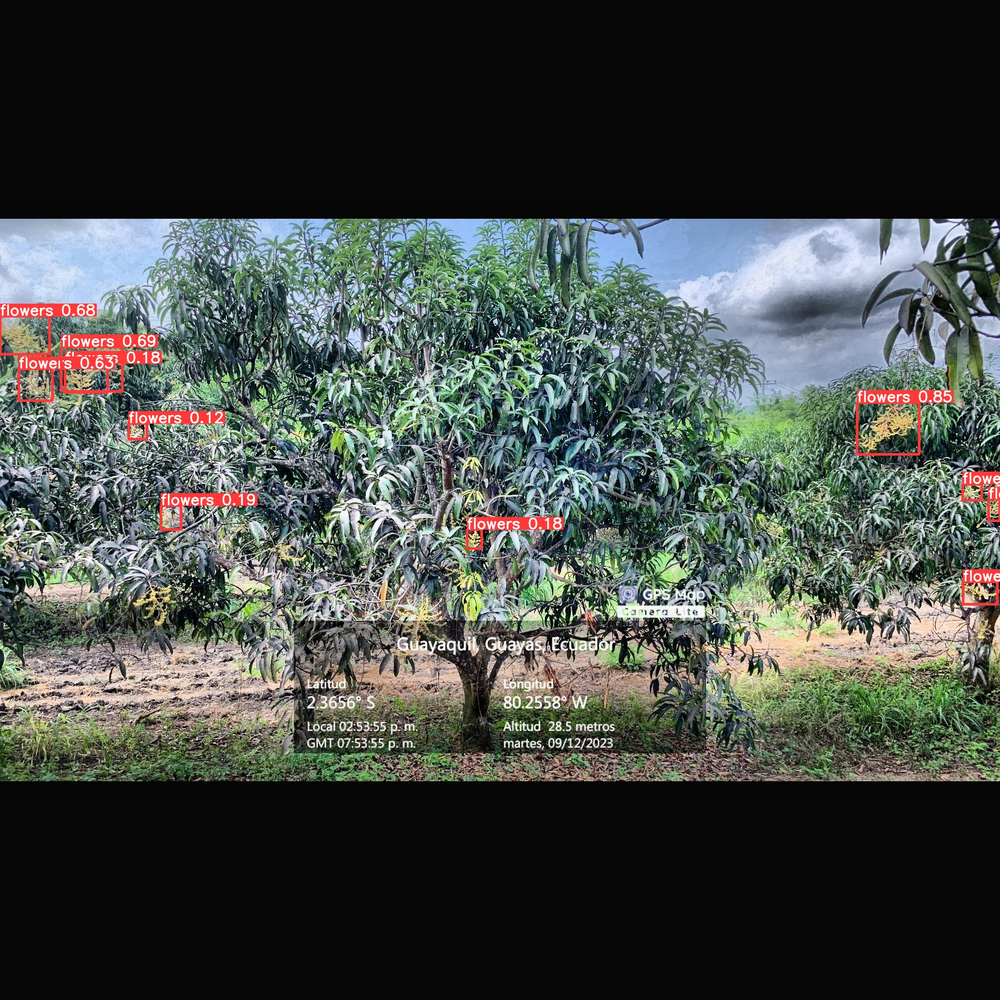

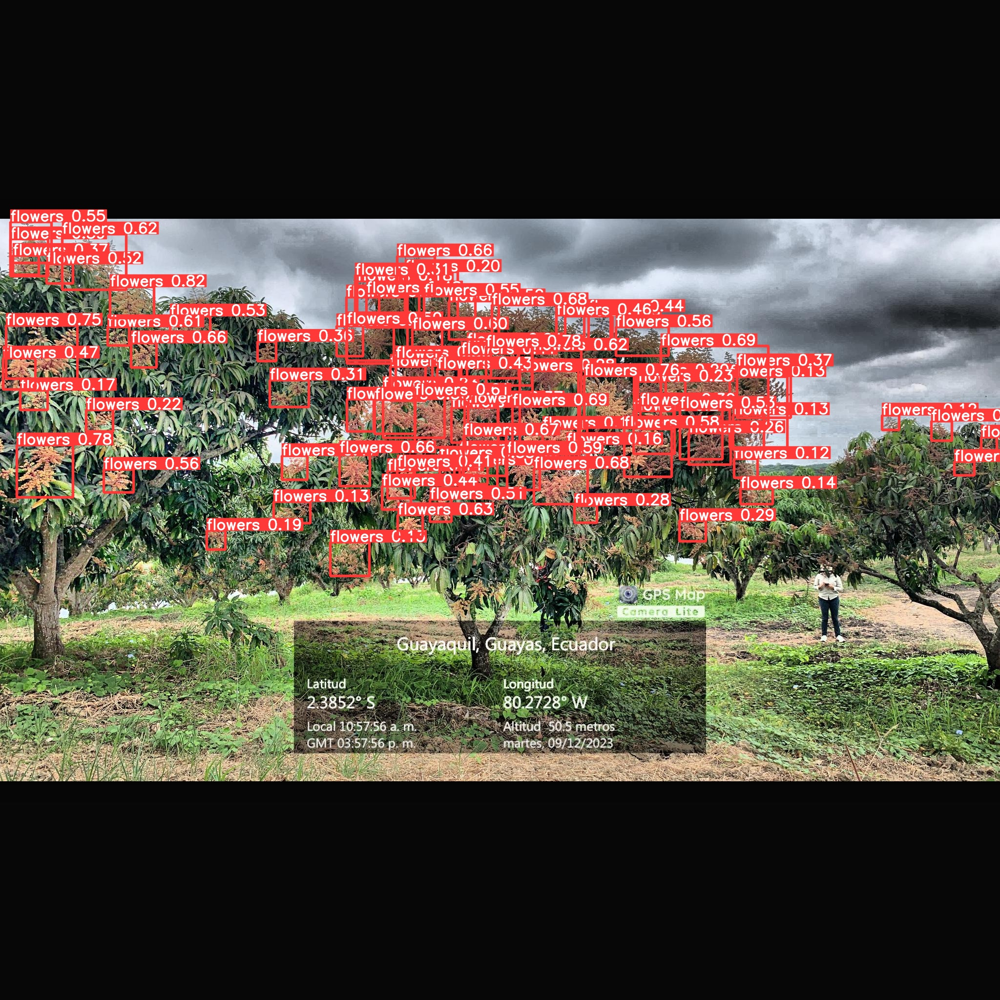

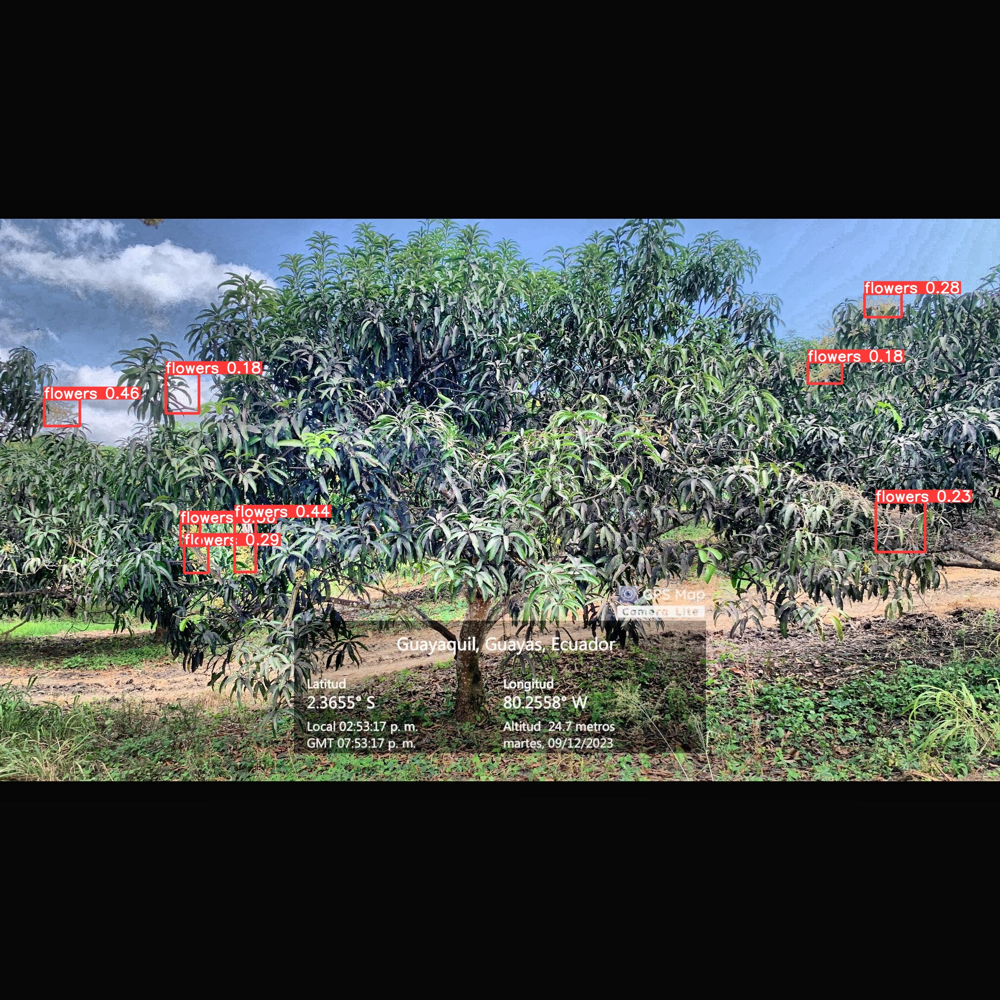

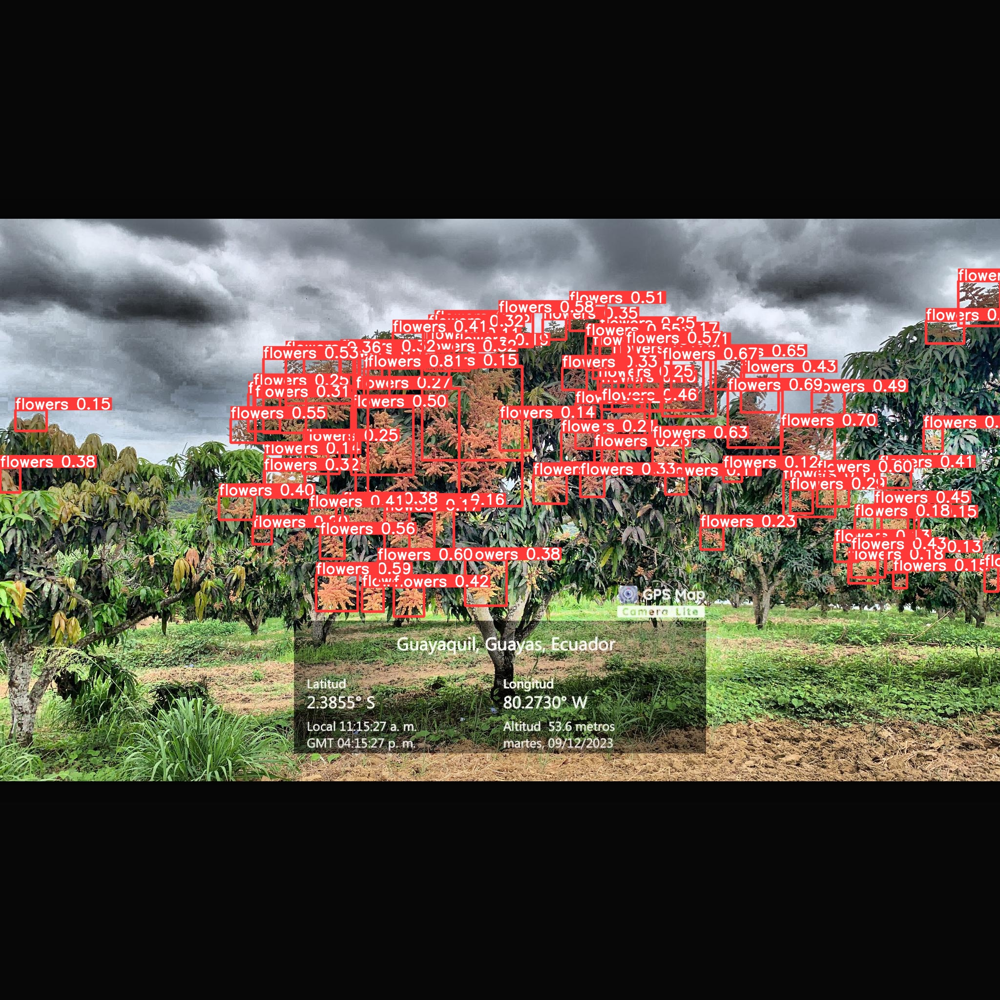

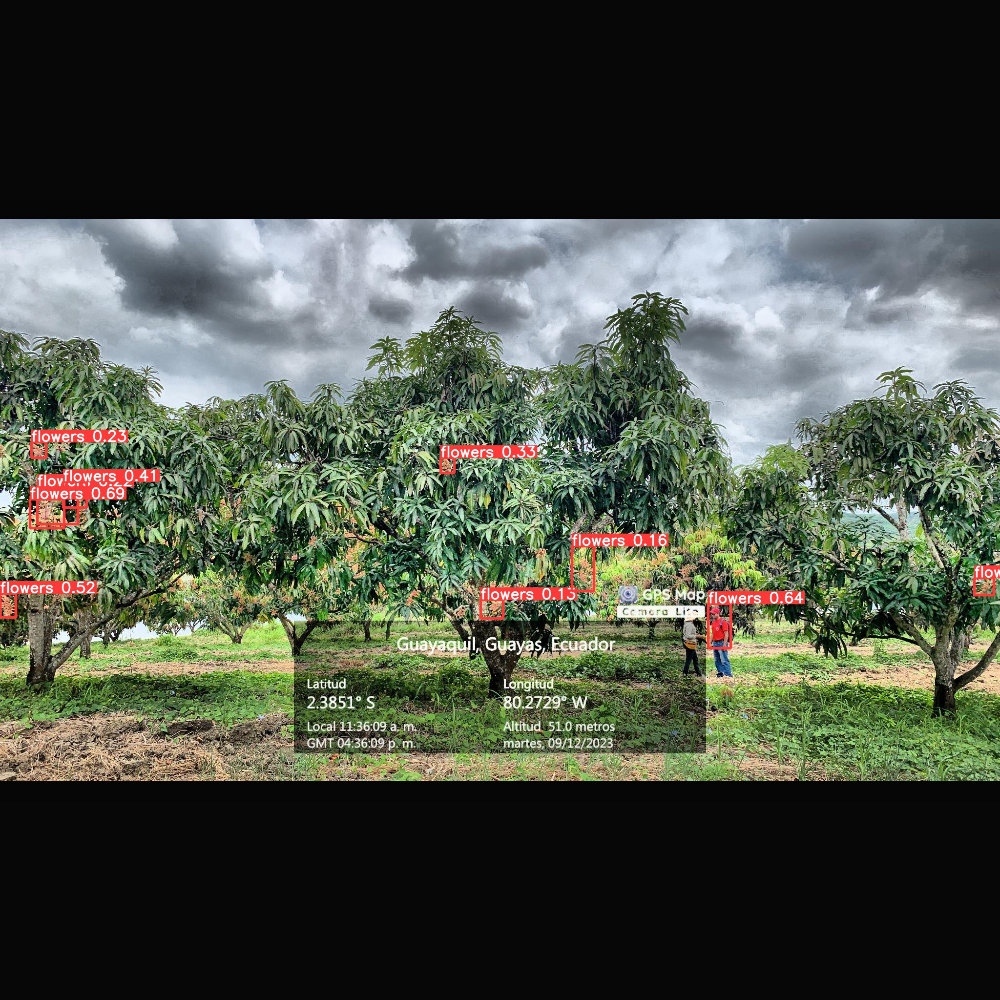

...

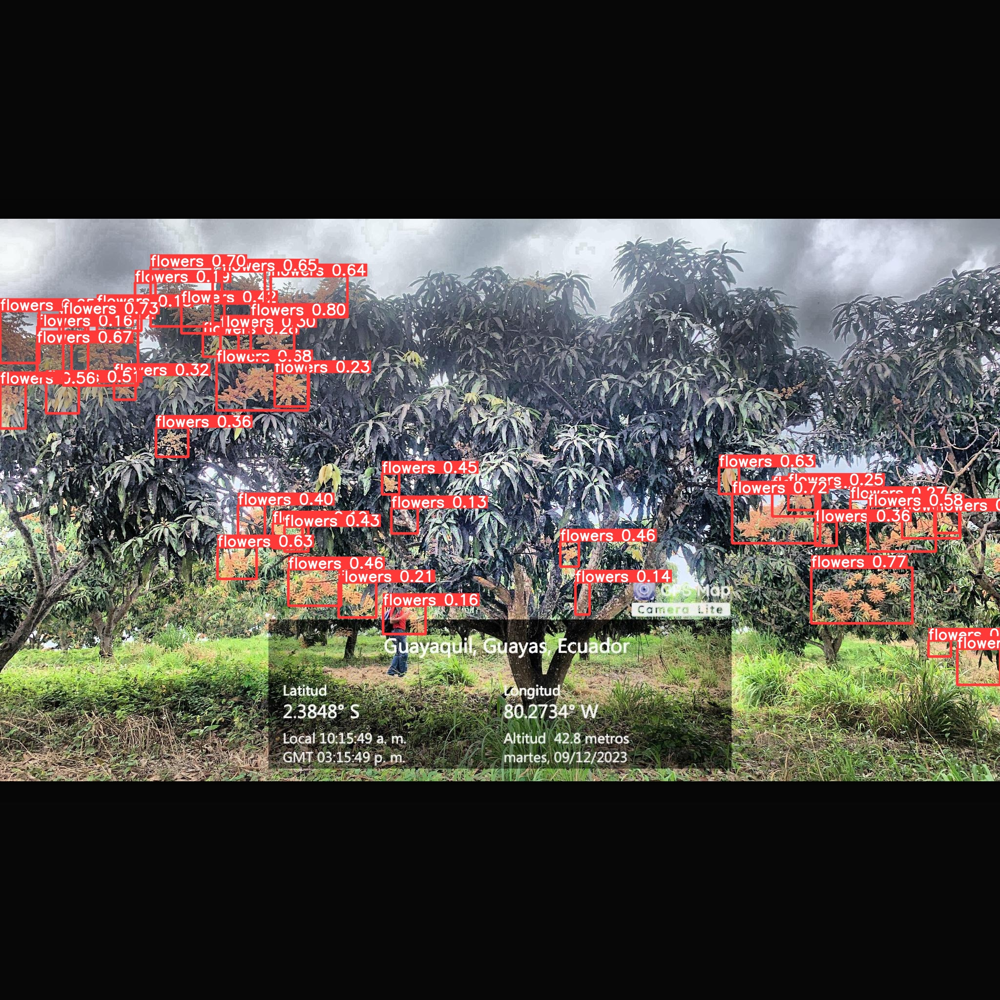

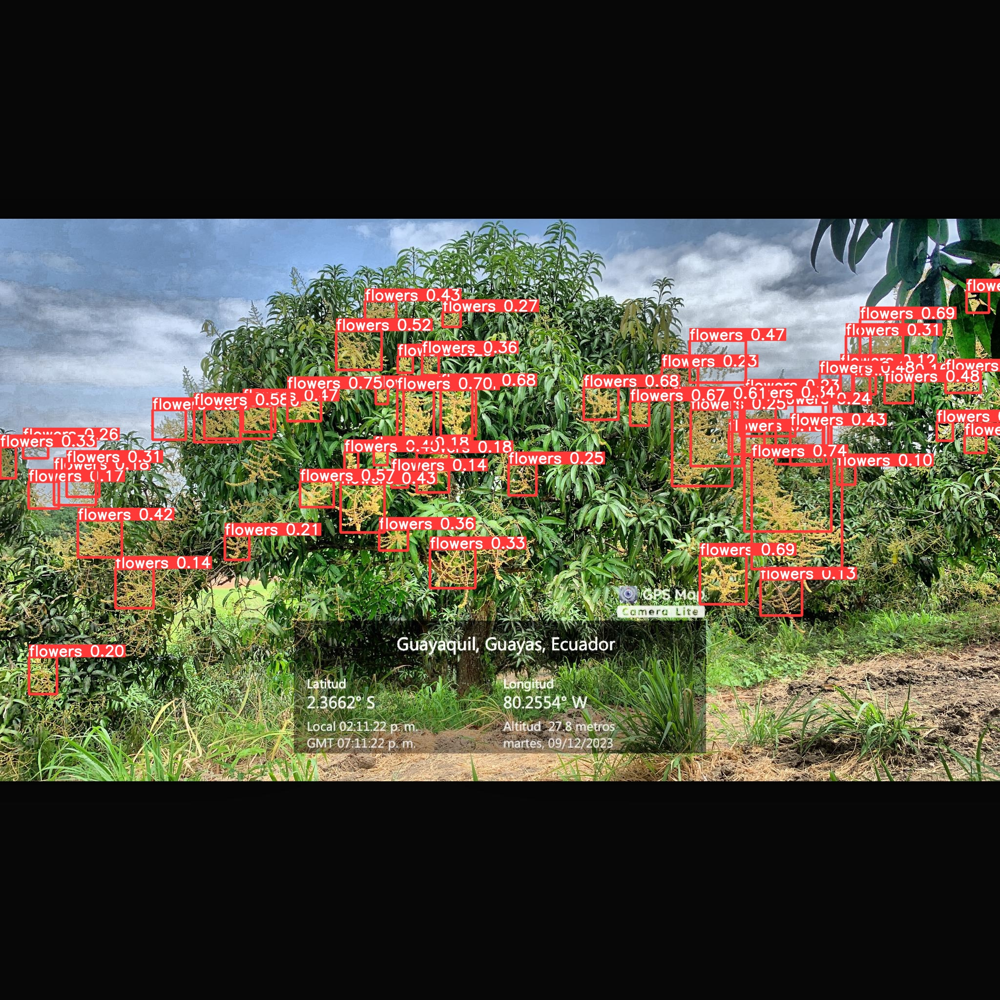

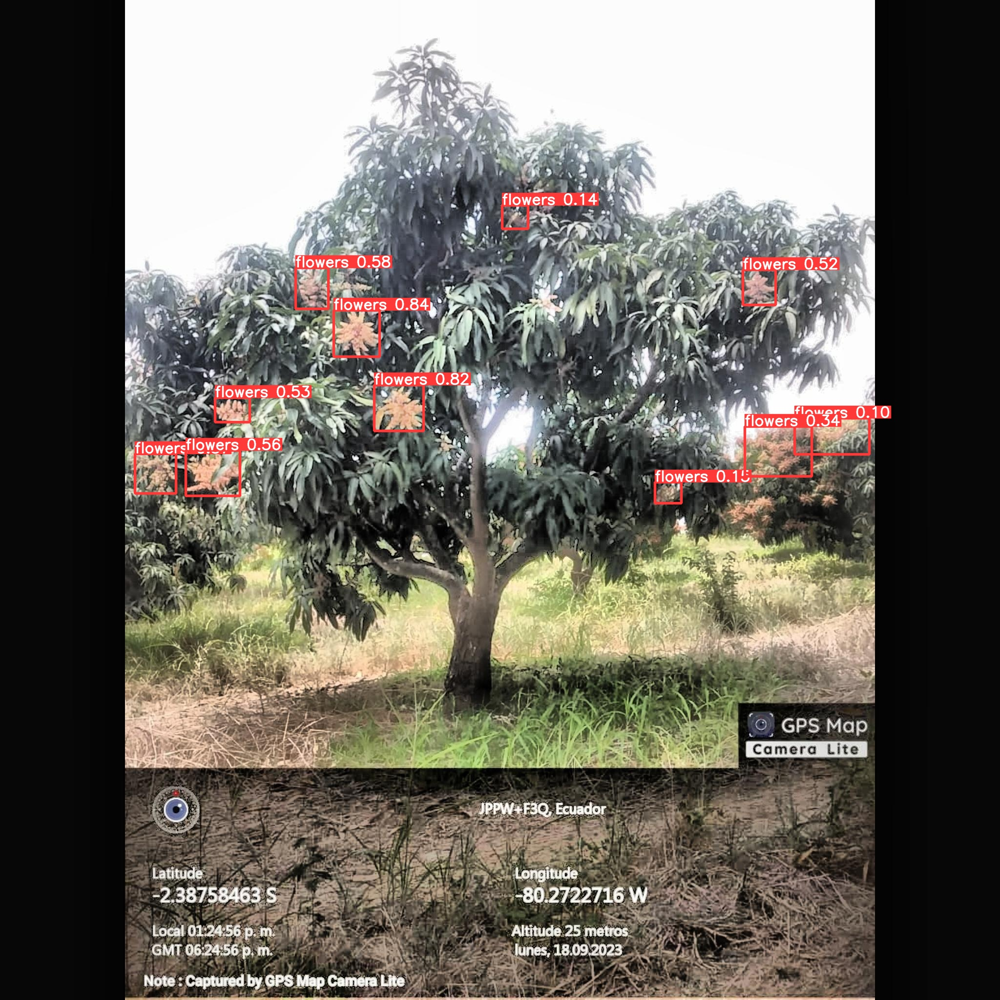

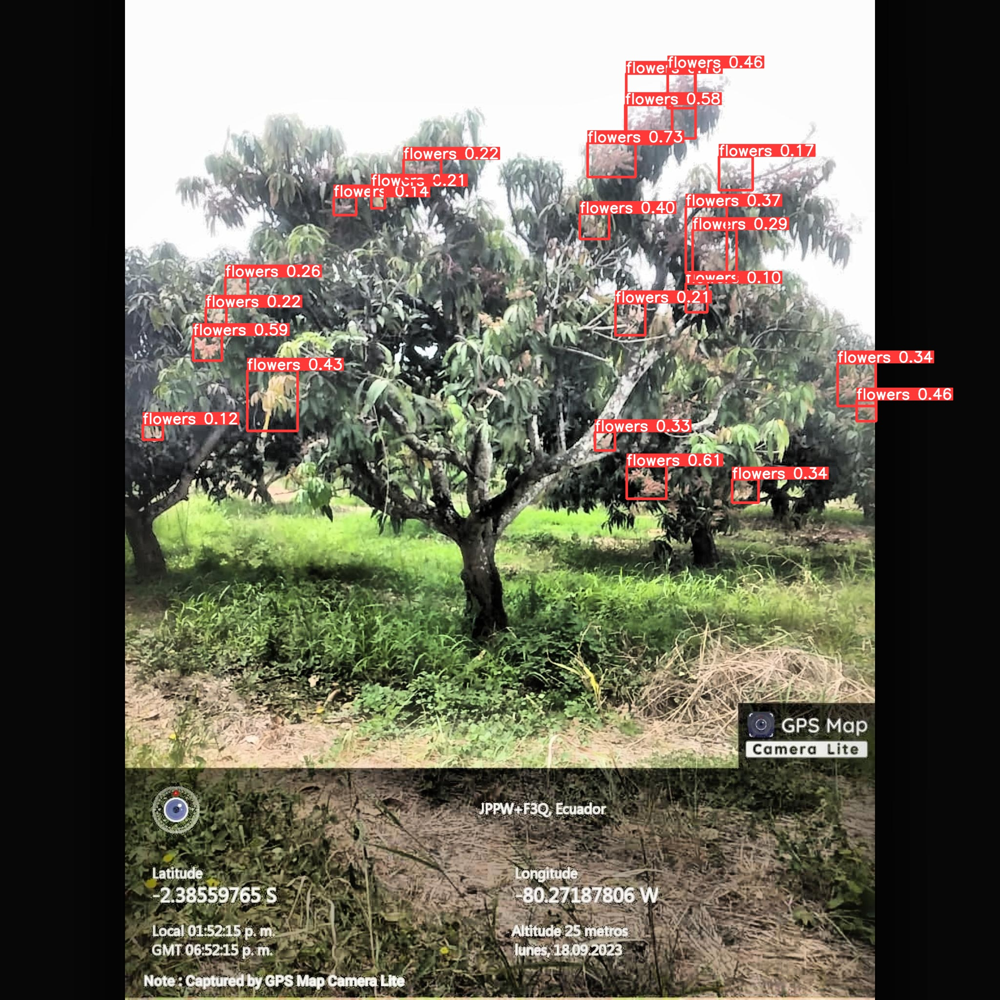

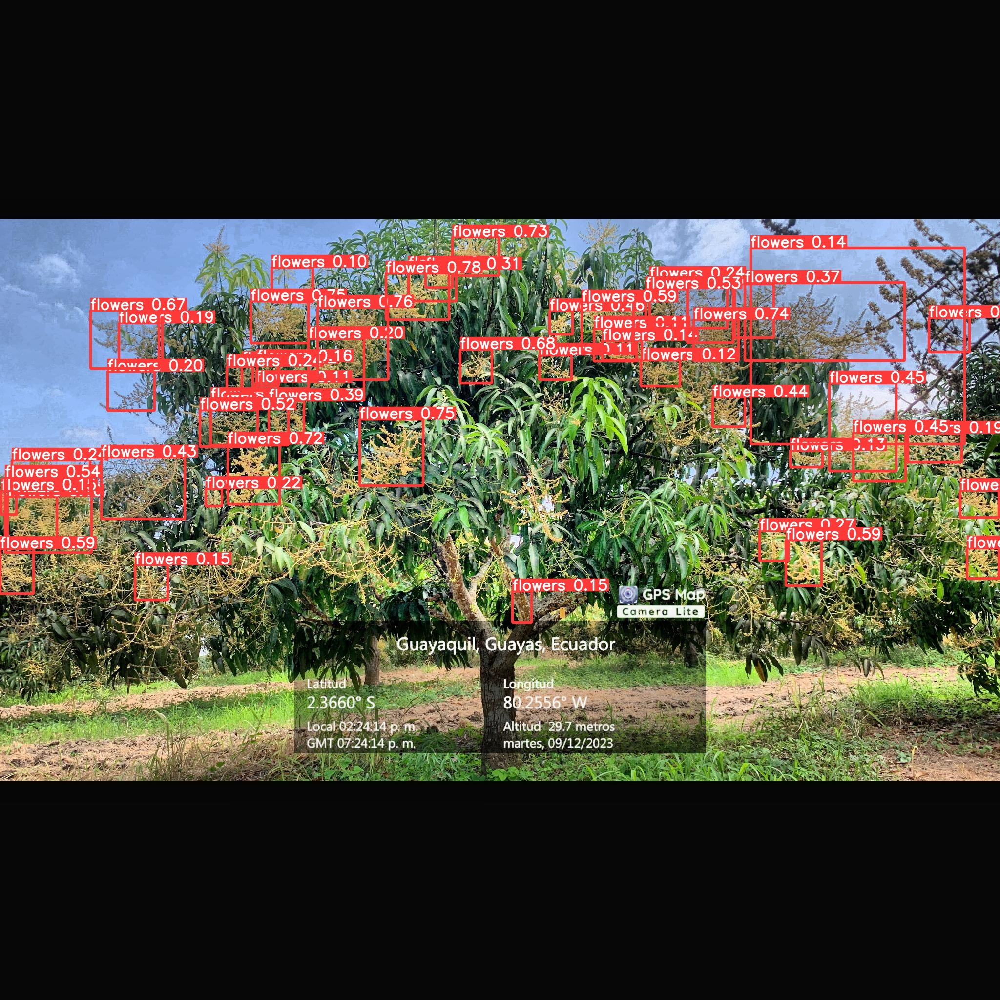

In [31]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Conclusion and Next Steps

Congratulations! You've trained a custom YOLOv5 model to recognize your custom objects.

To improve you model's performance, we recommend first interating on your datasets coverage and quality. See this guide for [model performance improvement](https://github.com/ultralytics/yolov5/wiki/Tips-for-Best-Training-Results).

To deploy your model to an application, see this guide on [exporting your model to deployment destinations](https://github.com/ultralytics/yolov5/issues/251).

Once your model is in production, you will want to continually iterate and improve on your dataset and model via [active learning](https://blog.roboflow.com/what-is-active-learning/).

In [20]:
# prompt: I need to get the bounding boxes of identified objects.

!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images --save-txt
#get bounding boxes from text files
import glob
import os
import pandas as pd
path = '/content/yolov5/runs/detect/exp2'
for txt_file in glob.glob(os.path.join(path, '*.txt')):
    df = pd.read_table(txt_file, sep=' ', header=None, names=['class', 'x_center', 'y_center', 'width', 'height'])
    print(df)


detect: weights=['runs/train/exp/weights/best.pt'], source=/Notebooks/yolov5/yolov5/Inflorescencias-7/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-294-gdb125a20 Python-3.10.9 torch-2.2.1+cu121 CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/15 /Notebooks/yolov5/yolov5/Inflorescencias-7/test/images/A2L1F10T5-A_jpg.rf.09488bb79918d477acc48ea629b119ef.jpg: 416x416 83 flowerss, 133.5ms
image 2/15 /Notebooks/yolov5/yolov5/Inflorescencias-7/test/images/A2L1F2T4-A_jpg.rf.c5ee855cbe77f921f2c4258095503559.jpg: 416x416 76 flowerss, 224.3ms
image 3/15 /Notebo